In [1]:
!pip install easyocr
!pip install imutils

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 2.9 MB 7.5 MB/s 
     |████████████████████████████████| 604 kB 41.6 MB/s 
     |████████████████████████████████| 47.6 MB 2.3 MB/s 
     |████████████████████████████████| 108 kB 40.8 MB/s 
  Attempting uninstall: opencv-python-headless
    Found existing installation: opencv-python-headless 4.6.0.66
    Uninstalling opencv-python-headless-4.6.0.66:
      Successfully uninstalled opencv-python-headless-4.6.0.66
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import cv2
import numpy as np
import imutils
import easyocr
from matplotlib import pyplot as plt
from os import listdir
from google.colab.patches import cv2_imshow

In [ ]:
directory = "/content/drive/MyDrive/4t Enginyeria de Dades/Matrícules/Noves"
files = [directory + "/" + f for f in listdir(directory)]
files

['/content/drive/MyDrive/4t Enginyeria de Dades/Matrícules/Noves/1663426589515.jpg',
 '/content/drive/MyDrive/4t Enginyeria de Dades/Matrícules/Noves/1663426589528.jpg',
 '/content/drive/MyDrive/4t Enginyeria de Dades/Matrícules/Noves/1663426589536.jpg',
 '/content/drive/MyDrive/4t Enginyeria de Dades/Matrícules/Noves/1663426589546.jpg',
 '/content/drive/MyDrive/4t Enginyeria de Dades/Matrícules/Noves/1663426589555.jpg',
 '/content/drive/MyDrive/4t Enginyeria de Dades/Matrícules/Noves/1663426589565.jpg',
 '/content/drive/MyDrive/4t Enginyeria de Dades/Matrícules/Noves/1663426589575.jpg',
 '/content/drive/MyDrive/4t Enginyeria de Dades/Matrícules/Noves/1663426589585.jpg',
 '/content/drive/MyDrive/4t Enginyeria de Dades/Matrícules/Noves/1663426589596.jpg',
 '/content/drive/MyDrive/4t Enginyeria de Dades/Matrícules/Noves/1663426589607.jpg',
 '/content/drive/MyDrive/4t Enginyeria de Dades/Matrícules/Noves/1663426589617.jpg',
 '/content/drive/MyDrive/4t Enginyeria de Dades/Matrí

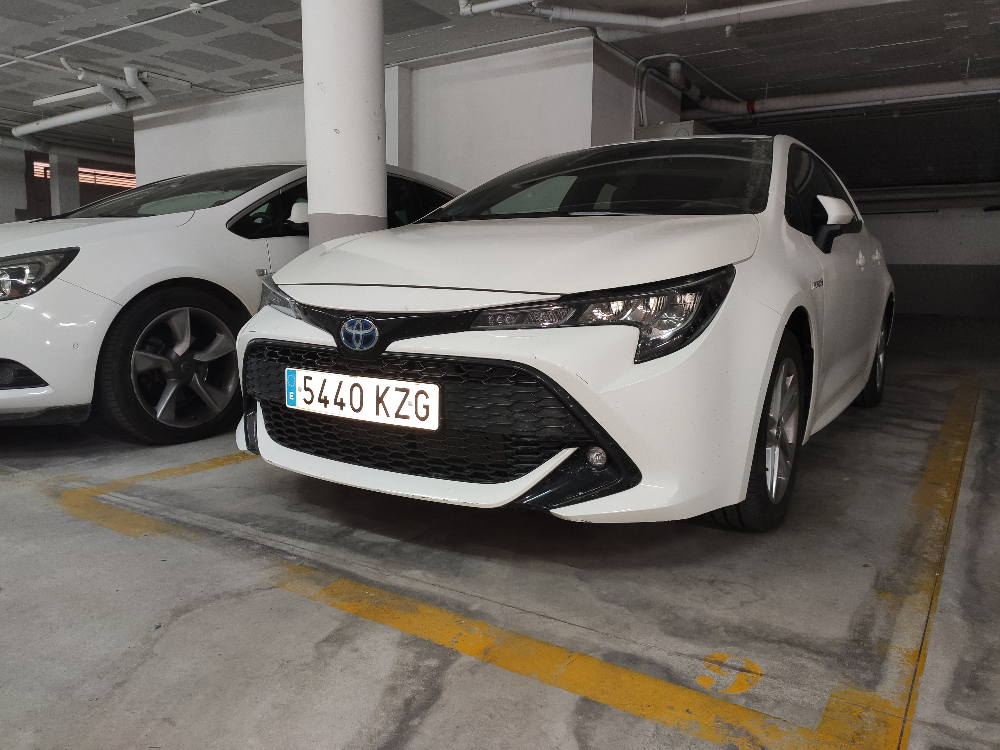

In [ ]:
img = cv2.imread(files[8])
#img = cv2.resize(img, (720,480) )
cv2_imshow(img)

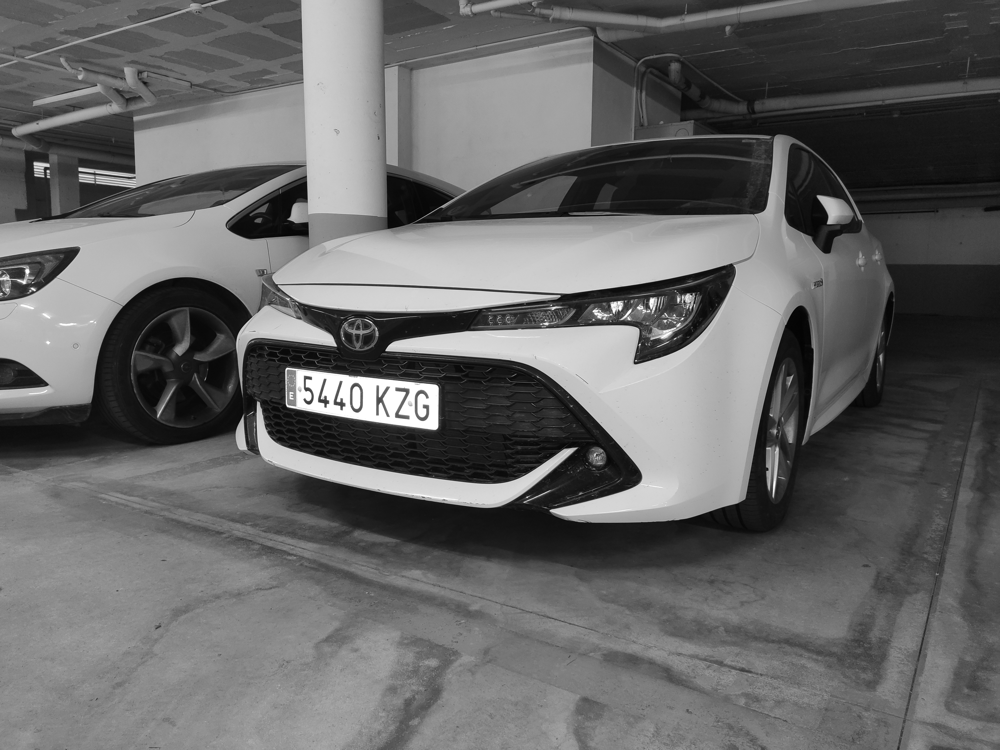

In [ ]:
gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
cv2_imshow(gray_img)

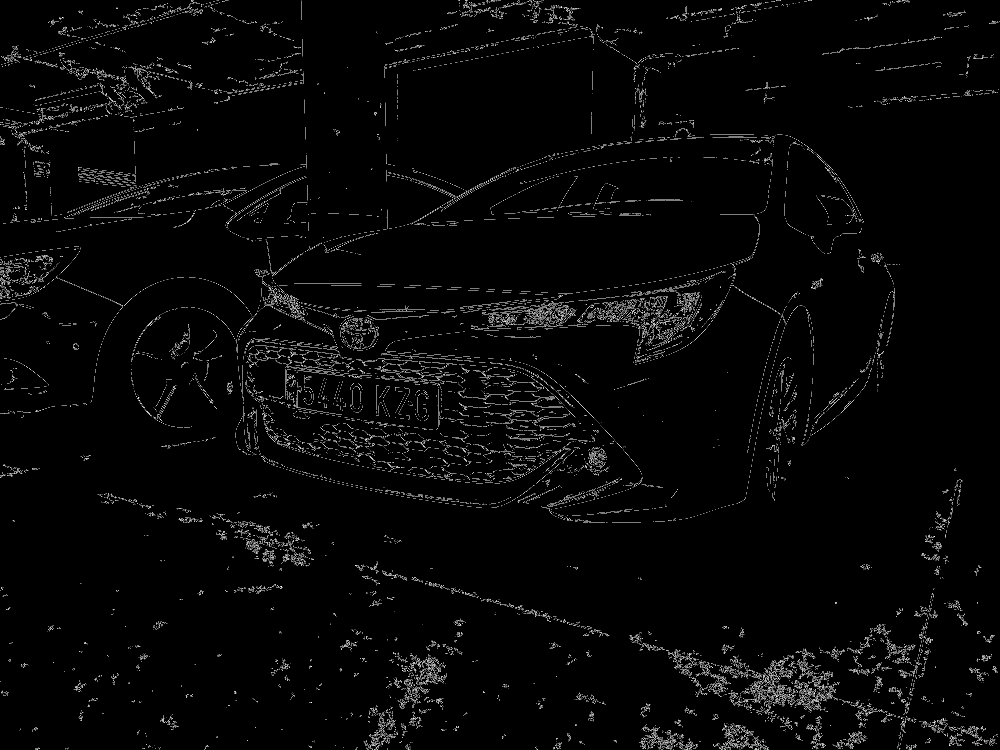

In [ ]:
edged = cv2.Canny(gray_img, 30, 200) 
contours = cv2.findContours(edged.copy(), cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
contours = imutils.grab_contours(contours)
contours = sorted(contours, key = cv2.contourArea, reverse = True)[:10]
screenCnt = None
cv2_imshow(edged)

In [ ]:


keypoints = cv2.findContours(edged.copy(), cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
contours = imutils.grab_contours(keypoints)
contours = sorted(contours, key=cv2.contourArea, reverse=True)[:10]


location = None
for contour in contours:
    approx = cv2.approxPolyDP(contour, 35, True)
    if len(approx) == 4:
        location = approx
        break
#mirar que l'area sigui gran, que la base sigui minim x2 de llarg que altura
print(location)

[[[1142 1475]]

 [[1149 1628]]

 [[1752 1711]]

 [[1744 1538]]]


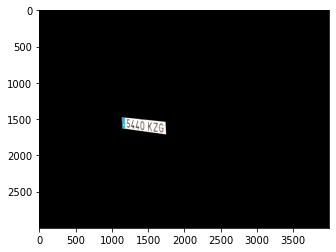

In [ ]:
mask = np.zeros(gray_img.shape, np.uint8)
new_image = cv2.drawContours(mask, [location], 0,255, -1)
new_image = cv2.bitwise_and(img, img, mask=mask)

plt.imshow(cv2.cvtColor(new_image, cv2.COLOR_BGR2RGB))

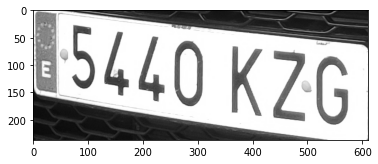

In [ ]:


(x,y) = np.where(mask==255)
(x1, y1) = (np.min(x), np.min(y))
(x2, y2) = (np.max(x), np.max(y))
cropped_image = gray_img[x1:x2+1, y1:y2+1]

plt.imshow(cv2.cvtColor(cropped_image, cv2.COLOR_BGR2RGB))

In [ ]:
reader = easyocr.Reader(['en'])
result = reader.readtext(cropped_image)
result

[([[53.9176248275737, -0.9674278622766472],
   [350.18374615321466, 48.64100119967543],
   [317.0823751724263, 200.96742786227665],
   [20.816253846785337, 151.35899880032457]],
  '5440',
  0.9727155566215515),
 ([[363.84851722201984, 41.036868663509274],
   [606.4542809643901, 76.70228543001942],
   [577.1514827779802, 232.96313133649073],
   [334.5457190356098, 197.29771456998057]],
  'KZG',
  0.44727751470322047)]

In [ ]:
!sudo apt install tesseract-ocr
!pip install pytesseract

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following package was automatically installed and is no longer required:
  libnvidia-common-460
Use 'sudo apt autoremove' to remove it.
The following additional packages will be installed:
  tesseract-ocr-eng tesseract-ocr-osd
The following NEW packages will be installed:
  tesseract-ocr tesseract-ocr-eng tesseract-ocr-osd
0 upgraded, 3 newly installed, 0 to remove and 20 not upgraded.
Need to get 4,795 kB of archives.
After this operation, 15.8 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu bionic/universe amd64 tesseract-ocr-eng all 4.00~git24-0e00fe6-1.2 [1,588 kB]
Get:2 http://archive.ubuntu.com/ubuntu bionic/universe amd64 tesseract-ocr-osd all 4.00~git24-0e00fe6-1.2 [2,989 kB]
Get:3 http://archive.ubuntu.com/ubuntu bionic/universe amd64 tesseract-ocr amd64 4.00~git2288-10f4998a-2 [218 kB]
Fetched 4,795 kB in 0s (12.8 MB/s)
debconf: unable to initia

In [ ]:
import pytesseract
#Read the number plate
text = pytesseract.image_to_string(cropped_image, config='--psm 11')
print("Detected license plate Number is:",text.replace("\n", "").replace(" ", ""))
print(repr(text))

Detected license plate Number is: £5440K7G
'£5440 K7G\n\x0c'
